<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Test-166" data-toc-modified-id="Test-166-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Test 166</a></span><ul class="toc-item"><li><span><a href="#Localization" data-toc-modified-id="Localization-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Localization</a></span></li><li><span><a href="#Scan-Matching" data-toc-modified-id="Scan-Matching-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Scan Matching</a></span></li><li><span><a href="#Prior" data-toc-modified-id="Prior-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Prior</a></span></li><li><span><a href="#Update" data-toc-modified-id="Update-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Update</a></span></li><li><span><a href="#Innovation" data-toc-modified-id="Innovation-1.5"><span class="toc-item-num">1.5&nbsp;&nbsp;</span>Innovation</a></span></li></ul></li></ul></div>

# Test 166
The following figure shows the comparison between ground truth and localization?

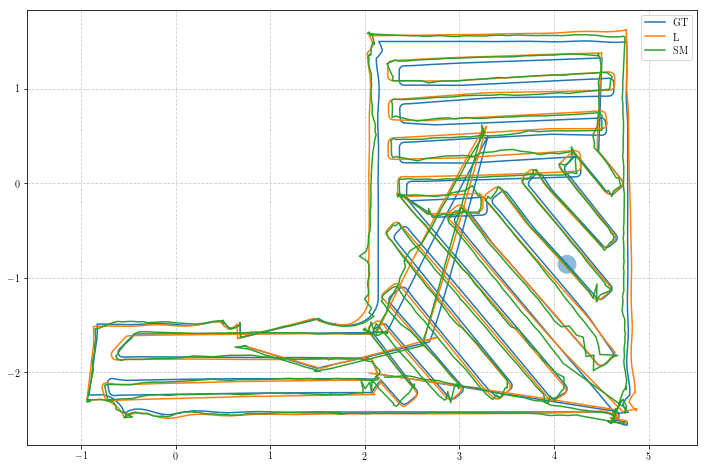

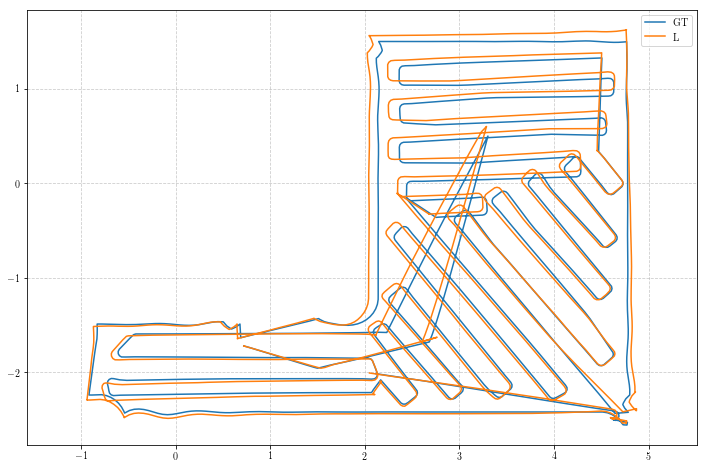

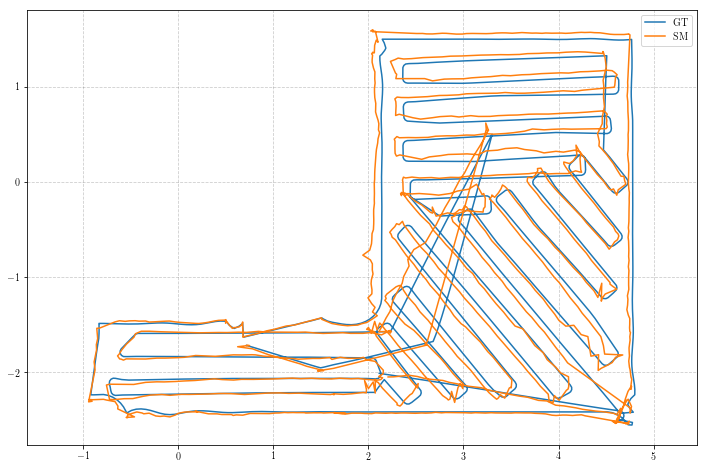

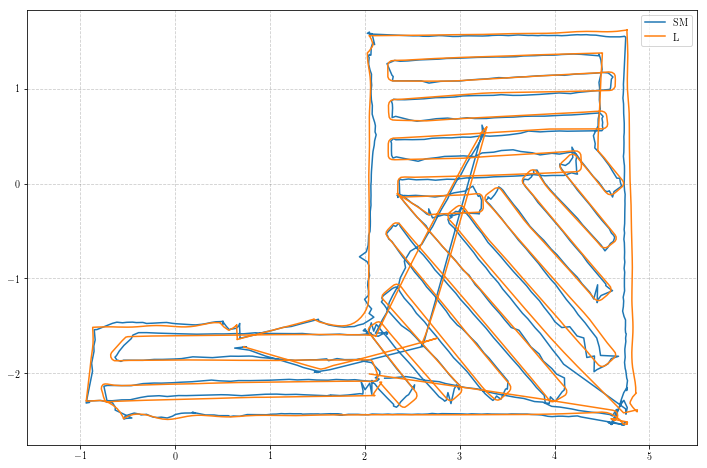

In [1]:
import pandas as pd
import re, csv
from scipy.stats import ttest_ind 
from scipy.stats import ttest_rel
from scipy import stats
import mpld3
from matplotlib import rc



from mpld3 import plugins
from mpld3._server import serve

import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
import matplotlib.pyplot as plt, mpld3
import matplotlib.patches as patches

mpld3.enable_notebook()

def covert_fig_to_html(fig):
    html = mpld3.fig_to_html(fig)
    html = html.replace('"height": 480.0, "width": 640.0','"height": 900.0, "width": 1600.0')
    return html

def eventpatch(ax, x, y, rad=0.1, al=0.5):
    patch = patches.Circle((x,y), radius=rad, alpha=al)
    ax.add_patch(patch)

fig_collection = []


result_folder = "/home/amirhossein/Desktop/references/compare_with_ground_truth/lm_icp_comparision"
test_folder = "/test_165"
method = "/icp_mod"

file_path = result_folder + test_folder + method + "/error_analysis.csv"

# file_path = "/home/amirhossein/bob_test_results/temp/error_analysis.csv"
df = pd.read_csv(file_path, header=None)
df.columns = ['t','x_gt', 'y_gt', 'th_gt', 'x_l', 'y_l', 'th_l', 'ex_l', 'ey_l', 'eth_l', 'e_pos_l_n',
              'e_ang_l_n', 'ex_l_lb', 'ex_l_ub', 'ey_l_lb', 'ey_l_ub', 'eth_l_lb', 'eth_l_ub', 'x_r',
              'y_r', 'th_r', 'ex_r', 'ey_r', 'eth_r', 'e_pos_r_n', 'e_ang_r_n', 'ex_r_lb', 'ex_r_ub', 
              'ey_r_lb', 'ey_r_ub', 'eth_r_lb', 'eth_r_ub', 'x_u', 'y_u', 'th_u', 'ex_u', 'ey_u', 'eth_u',
              'e_pos_u_n', 'e_ang_u_n', 'ex_u_lb', 'ex_u_ub', 'ey_u_lb', 'ey_u_ub', 'eth_u_lb', 'eth_u_ub','s']

plt.rcParams['figure.figsize'] = [12, 8]
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

fig = plt.figure();
ax =fig.add_subplot(111)

# ax = plt.plot(df['x_gt'], df['y_gt'], marker='.')
# plt.plot(df['x_l'], df['y_l'], marker='.')
# plt.plot(df['x_u'], df['y_u'], marker='.')
plt.plot(df['x_gt'], df['y_gt'])
plt.plot(df['x_l'], df['y_l'])
plt.plot(df['x_u'], df['y_u'])

eventpatch(ax, df.loc[800, 'x_gt'], df.loc[800, 'y_gt'], rad=0.01, al=0.8)
eventpatch(ax, df.loc[800, 'x_gt'], df.loc[800, 'y_gt'], rad=0.1, al=0.5)


plt.legend(['GT','L','SM'])
plt.axis('equal')
plt.grid(color='k', linestyle='--', alpha = 0.2)



fig = plt.figure();

ax = plt.plot(df['x_gt'], df['y_gt'])
plt.plot(df['x_l'], df['y_l'])
plt.legend(['GT','L'])
plt.axis('equal')
plt.grid(color='k', linestyle='--', alpha = 0.2)

fig = plt.figure();
ax =fig.add_subplot(111)

plt.plot(df['x_gt'], df['y_gt'])
plt.plot(df['x_u'], df['y_u'])
plt.legend(['GT','SM'])
plt.axis('equal')
plt.grid(color='k', linestyle='--', alpha = 0.2)

fig = plt.figure();
plt.plot(df['x_u'], df['y_u'])
plt.plot(df['x_l'], df['y_l'])
plt.legend(['SM','L'])
plt.axis('equal')
plt.grid(color='k', linestyle='--', alpha = 0.2)

In [2]:
plt.rcParams['figure.figsize'] = [12, 8]
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

# Define some CSS to control our custom labels
css = """
table
{
  border-collapse: collapse;
}
th
{
  color: #ffffff;
  background-color: #000000;
}
td
{
  background-color: #cccccc;
}
table, th, td
{
  font-family:Arial, Helvetica, sans-serif;
  border: 1px solid black;
  text-align: right;
}
"""

def build_labels(df, choices):
    df_sel = df[choices]
    labels = []
    label = pd.DataFrame()
    for index, row in df_sel.iterrows():
        label = row.T
        label = label.to_frame();
        label.columns = ['T# {0}'.format(index+1)]
        # .to_html() is unicode; so make leading 'u' go away with str()
        labels.append(str(label.to_html()))

    return labels  


def drawmap(df, lb, ub, v, ttl):
    fig = plt.figure();
    ax =fig.gca()
    plt.xlabel('step')
    plt.ylabel('error')
    plt.title(ttl)
    
    axes1, = plt.plot(df['t'], df[ub], ls='-', marker='.', color='C1', label=r'3 sigma')
    axes2, = plt.plot(df['t'], df[lb], ls='-', marker='.', color='C1', label='c')
    axes3, = plt.plot(df['t'], df[v], ls='-', marker='.', color='C0', label='error')

    labels1 = df[ub].tolist()
    labels2 = df[ub].tolist()
#   labels3 = df[v].tolist()


    ax.legend(handles=[axes1, axes3])

    tooltip1 = mpld3.plugins.PointLabelTooltip(axes1, labels=labels1)
    tooltip2 = mpld3.plugins.PointLabelTooltip(axes2, labels=labels2)
#     tooltip3 = mpld3.plugins.PointLabelTooltip(axes3, labels=labels3)
    tooltip3 = mpld3.plugins.PointHTMLTooltip(axes3, build_labels(df,['t',v,ub,lb]), voffset=10, hoffset=10, css=css)
    
    ax.grid(color='k', linestyle='--', alpha = 0.2)

    mpld3.plugins.connect(fig, tooltip1, tooltip2, tooltip3)


def drawerrorelement(df, var ,mthd, ttl):
    lb = 'e'+var+'_'+ mthd + '_lb'
    ub = 'e'+var+'_'+ mthd + '_ub'
    v = 'e'+var+'_'+ mthd 
    ttle = ttl + ' - ' + var
    drawmap(df, lb, ub, v, ttle)

def drawerror(df, mthd, ttl):
    drawerrorelement(df, 'x', mthd, ttl)
    drawerrorelement(df, 'y', mthd, ttl)
    drawerrorelement(df, 'th', mthd, ttl)


## Localization

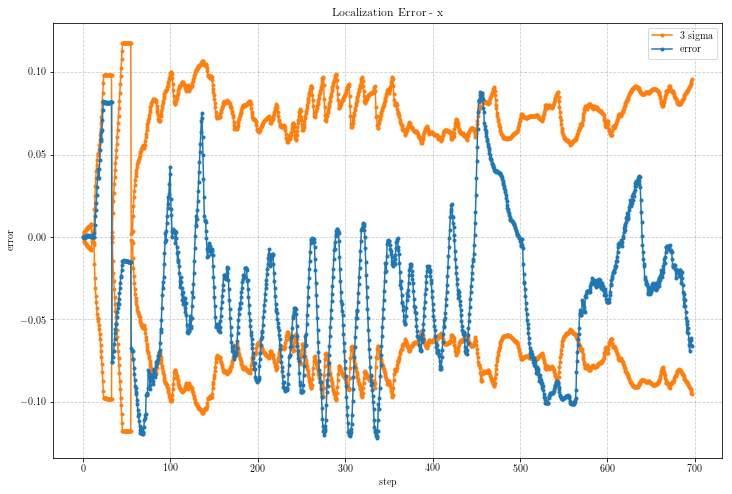

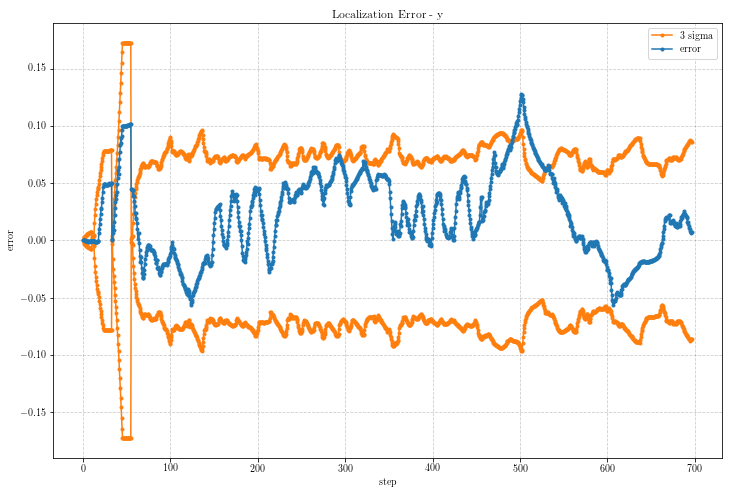

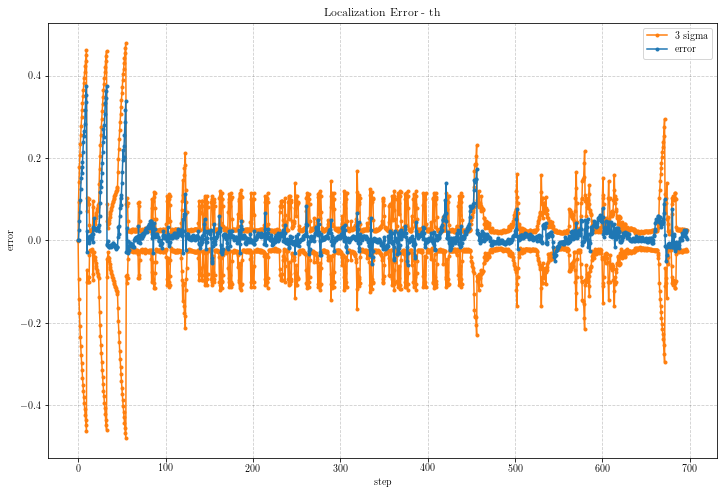

In [3]:
drawerror(df, 'l', 'Localization Error')

## Scan Matching

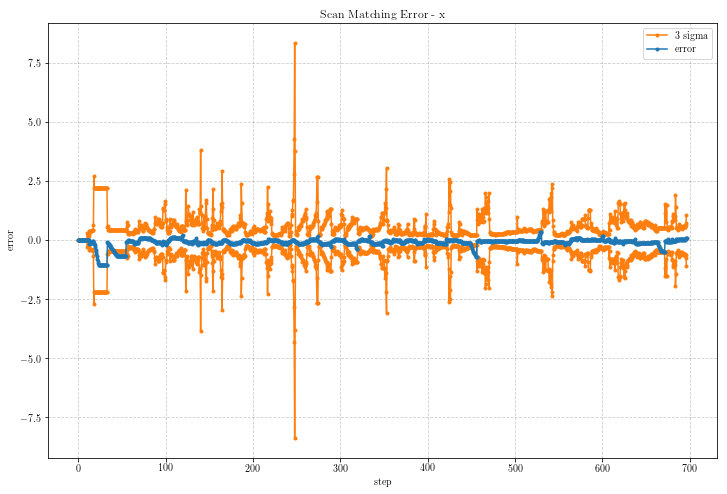

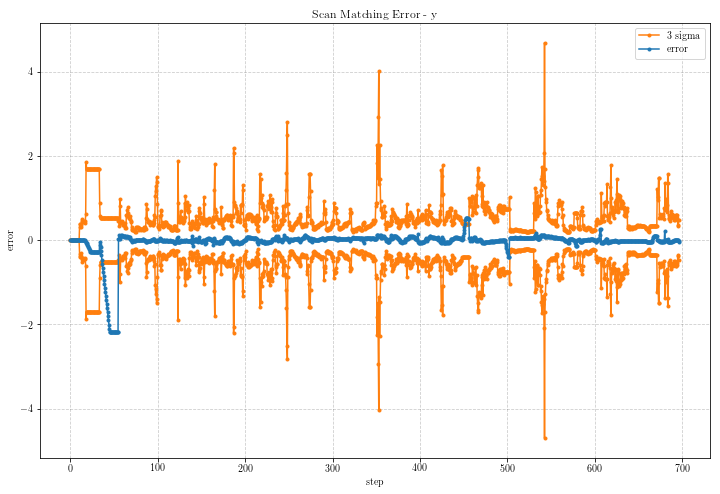

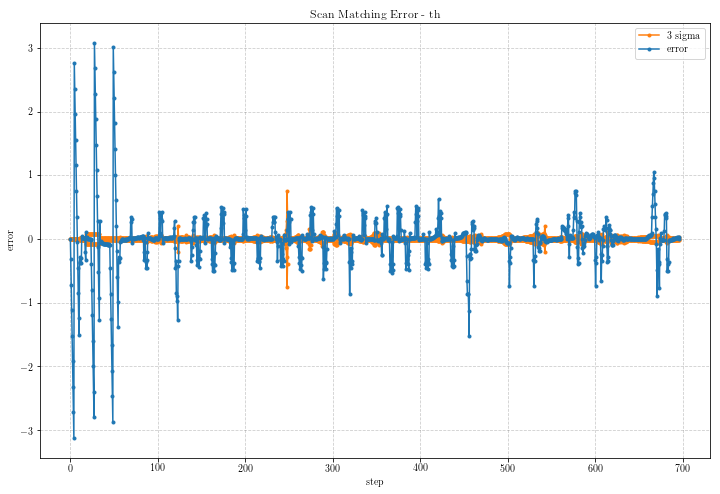

In [4]:
drawerror(df, 'u', 'Scan Matching Error')

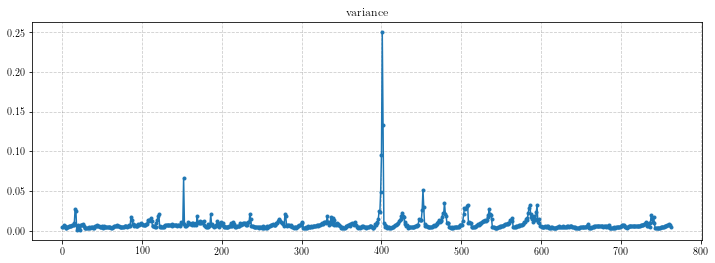

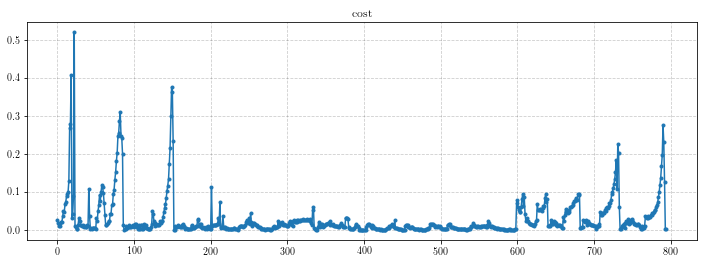

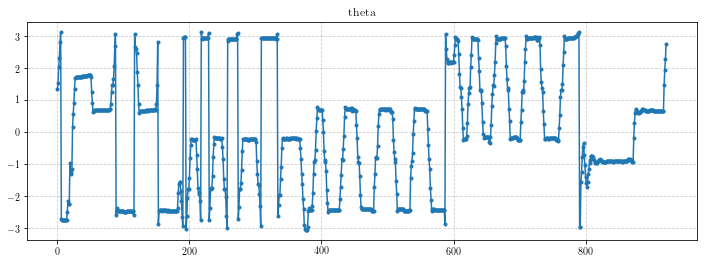

In [5]:
file_path1 = result_folder + test_folder + method +"/mmsm_analysis.csv"
file_path2 = result_folder + test_folder + method +"/mmsm_cost_analysis.csv"
file_path3 = result_folder + test_folder + method +"/mmsm_theta_analysis.csv"

df_mma = pd.read_csv(file_path1, header=None, sep='\s+')
df_mmca = pd.read_csv(file_path2, header=None, sep='\s+')
df_mmta = pd.read_csv(file_path3, header=None, sep='\s+')
plt.rcParams['figure.figsize'] = [12, 4]

def plotColumn(df,ttl):
    fig = plt.figure();
    ax =fig.gca()
    axes1, = plt.plot(df.iloc[0], ls='-', marker='.', color='C0')
    plt.title(ttl)
    ax.grid(color='k', linestyle='--', alpha = 0.2)
    labels1 = df.iloc[0].tolist()
    tooltip1 = mpld3.plugins.PointLabelTooltip(axes1, labels=labels1)
    mpld3.plugins.connect(fig, tooltip1)


plotColumn(df_mma, 'variance')
plotColumn(df_mmca, 'cost')
plotColumn(df_mmta, 'theta')

plt.show()

In [6]:
print("Localization Stat")
print(abs(df.loc[:,['ex_l', 'ey_l', 'eth_l']]).mean())
print(abs(df.loc[:,['ex_l', 'ey_l', 'eth_l']]).std())

Localization Stat
ex_l     0.045956
ey_l     0.034370
eth_l    0.022942
dtype: float64
ex_l     0.031915
ey_l     0.025761
eth_l    0.043961
dtype: float64


In [7]:
print("Localization Stat")
print(abs(df.loc[:,['ex_u', 'ey_u', 'eth_u']]).mean())
print(abs(df.loc[:,['ex_u', 'ey_u', 'eth_u']]).std())

Localization Stat
ex_u     0.107397
ey_u     0.096579
eth_u    0.167565
dtype: float64
ex_u     0.167002
ey_u     0.299351
eth_u    0.365821
dtype: float64


## Prior

In [8]:
# file_path = "/home/amirhossein/bob_test_results/temp/error_analysis.csv"
# 	ofs << time << "," << prior.pose.position.x << "," << prior.pose.position.y << "," << prior.pose.theta << "," <<
# 					prior.covariance(0,0) << "," << prior.covariance(1,1) << "," << prior.covariance(2,2) << 
# 					"," << 	update.pose.position.x << "," << update.pose.position.y << "," << update.pose.theta << "," <<
# 					update.covariance(0,0) << "," << update.covariance(1,1) << "," << update.covariance(2,2) << 
# 					"," << innovation.position.x << "," << innovation.position.y << "," << innovation.theta << "," <<
# 					inovationResodualCovariance(0,0) << "," << inovationResodualCovariance(1,1) << "," << inovationResodualCovariance(2,2) << 
# 					"\n";
ekf_file_path = result_folder + test_folder + method + "/ekf_analysis.csv"

dfekf = pd.read_csv(ekf_file_path, header=None)
dfekf.columns = ['t','x_p', 'y_p', 'th_p', 'ex_p_ub', 'ey_p_ub', 'eth_p_ub', 
                     'x_u', 'y_u', 'th_u', 'ex_u_ub', 'ey_u_ub', 'eth_u_ub',
                     'x_i', 'y_i', 'th_i', 'ex_i_ub', 'ey_i_ub', 'eth_i_ub']

In [9]:

def drawmapwcov(df, ub, v, ttl):
    fig = plt.figure();
    ax =fig.gca()
    plt.xlabel('step')
    plt.ylabel('error')
    plt.title(ttl)
    
    axes1, = plt.plot(df['t'], 3*(df[ub].pow(1./2)), ls='-', marker='.', color='C1', label=r'3 sigma')
    axes2, = plt.plot(df['t'], -3*(df[ub].pow(1./2)), ls='-', marker='.', color='C1', label='c')
    axes3, = plt.plot(df['t'], df[v], ls='-', marker='.', color='C0', label='error')

    labels1 = df[ub].tolist()
    labels2 = df[ub].tolist()
#   labels3 = df[v].tolist()


    ax.legend(handles=[axes1, axes3])

    tooltip1 = mpld3.plugins.PointLabelTooltip(axes1, labels=labels1)
    tooltip2 = mpld3.plugins.PointLabelTooltip(axes2, labels=labels2)
#     tooltip3 = mpld3.plugins.PointLabelTooltip(axes3, labels=labels3)
    tooltip3 = mpld3.plugins.PointHTMLTooltip(axes3, build_labels(df,['t',v,ub,ub]), voffset=10, hoffset=10, css=css)
    
    ax.grid(color='k', linestyle='--', alpha = 0.2)

    mpld3.plugins.connect(fig, tooltip1, tooltip2, tooltip3)


def drawerrorelementwcov(df, var ,mthd, ttl):
    ub = 'e'+var+'_'+ mthd + '_ub'
    v = var+'_'+ mthd 
    ttle = ttl + ' - ' + var
    drawmapwcov(df, ub, v, ttle)

def drawerrorwcov(df, mthd, ttl):
    drawerrorelementwcov(df, 'x', mthd, ttl)
    drawerrorelementwcov(df, 'y', mthd, ttl)
    drawerrorelementwcov(df, 'th', mthd, ttl)


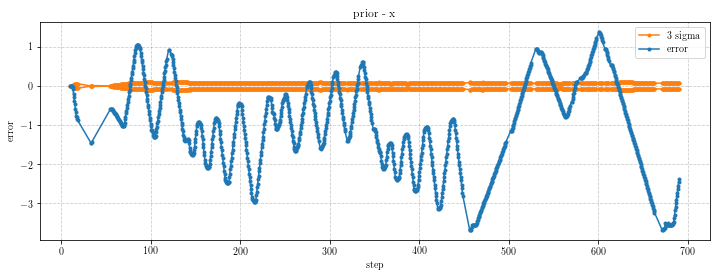

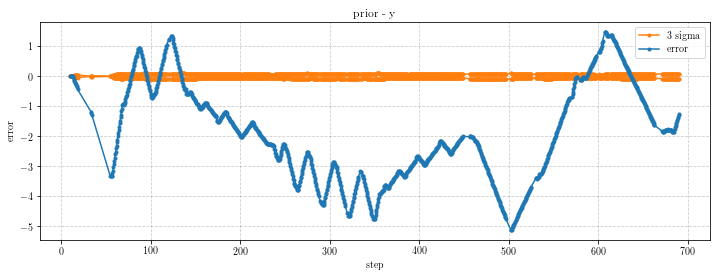

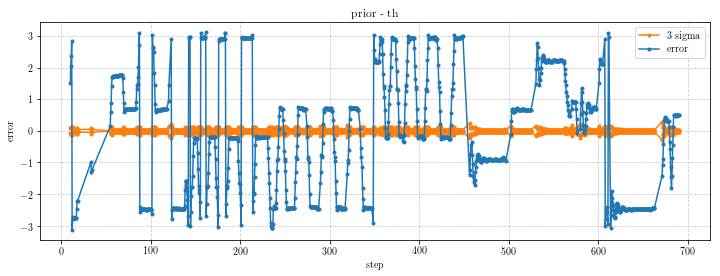

In [10]:
drawerrorwcov(dfekf, 'p', 'prior')

## Update

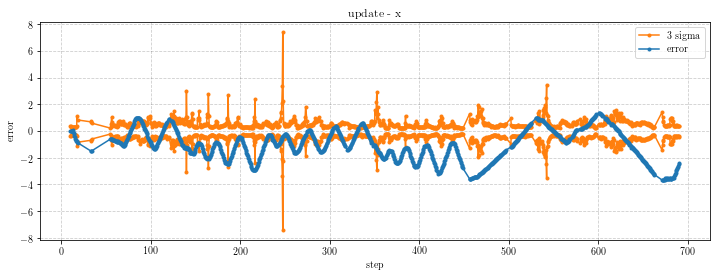

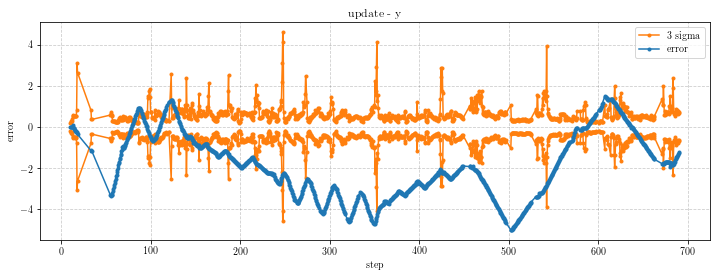

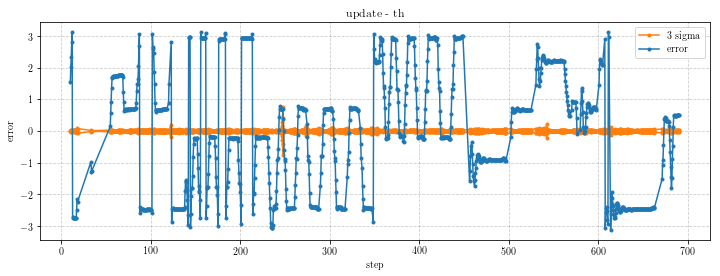

In [11]:
drawerrorwcov(dfekf, 'u', 'update')

## Innovation 

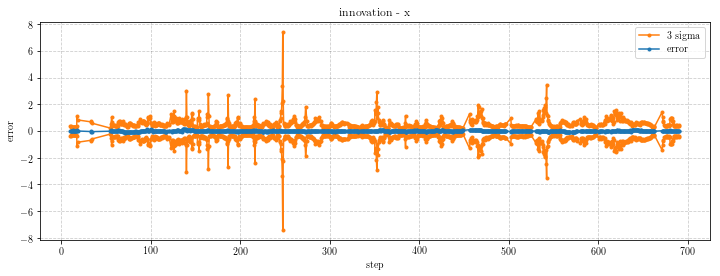

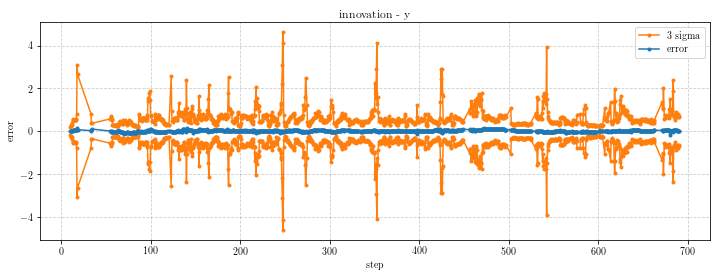

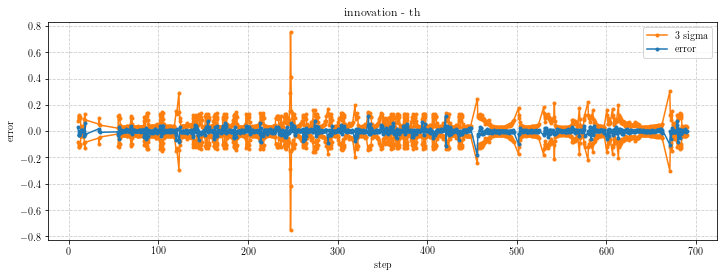

In [12]:
drawerrorwcov(dfekf, 'i', 'innovation')

In [13]:
print("Innovation Stat")
print(abs(dfekf.loc[:,['x_i', 'y_i', 'th_i']]).mean())
print(abs(dfekf.loc[:,['x_i', 'y_i', 'th_i']]).std())

Innovation Stat
x_i     0.026761
y_i     0.029340
th_i    0.011770
dtype: float64
x_i     0.023422
y_i     0.025146
th_i    0.016461
dtype: float64
